##Part 1:

In [153]:
from google.colab import drive
drive.mount('/content/drive')
from PIL import Image, ImageEnhance, ImageFilter
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd
import colorsys
from skimage.filters import gabor, gaussian
from IPython.display import display
from pywt import dwt2
import pickle
from google.colab.patches import cv2_imshow
from skimage.metrics import structural_similarity as ssim

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:

google_drive_folder = "/content/drive/My Drive/Bio vision/Biological Vision Assignment 1/"


image_files = ["1.png", "2.jpg", "3.png", "4.jpg", "5.jpg", "6.jpg", "7.png", "8.jpg", "9.jpg", "10.jpg"]


for image_file in image_files:
    image_path = google_drive_folder + image_file
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title(f"Image: {image_file}")
    plt.axis('off')
    plt.show()

    descriptions = {
        "1.png": "Traing with lots of buildings",
        "2.jpg": "A paper flower",
        "3.png": "Train with lots of buildings but with less size",
        "4.jpg": "green leaves",
        "5.jpg": "small car",
        "6.jpg": "butterfly",
        "7.png": "girl",
        "8.jpg": "keyboard",
        "9.jpg": "coder",
        "10.jpg": "girl listening to music"
    }

    print(f"Description: {descriptions.get(image_file)}")


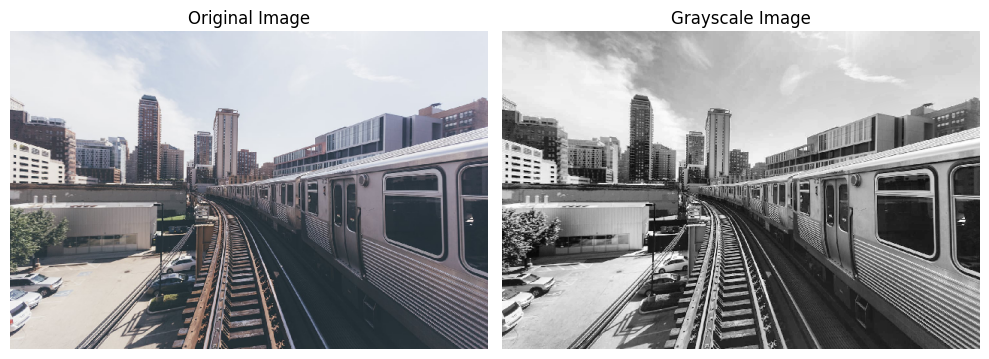

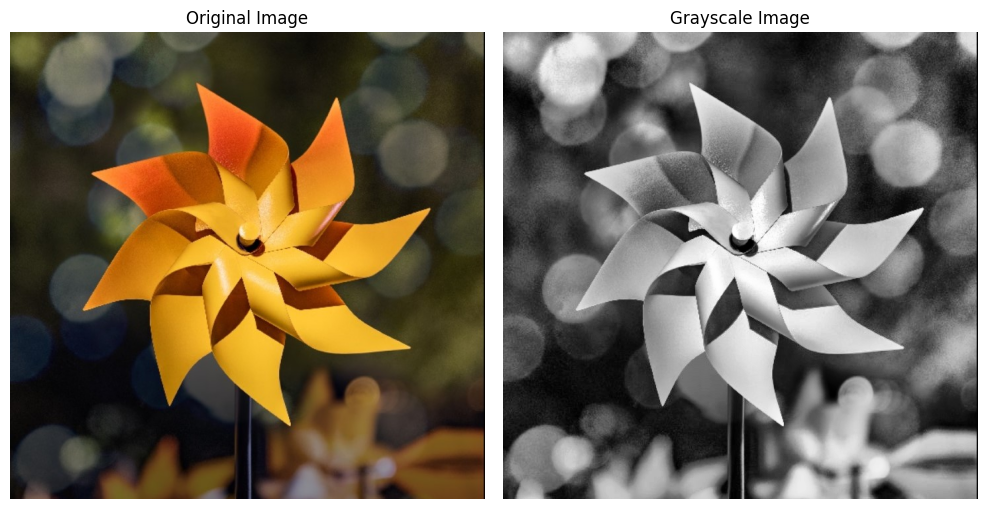

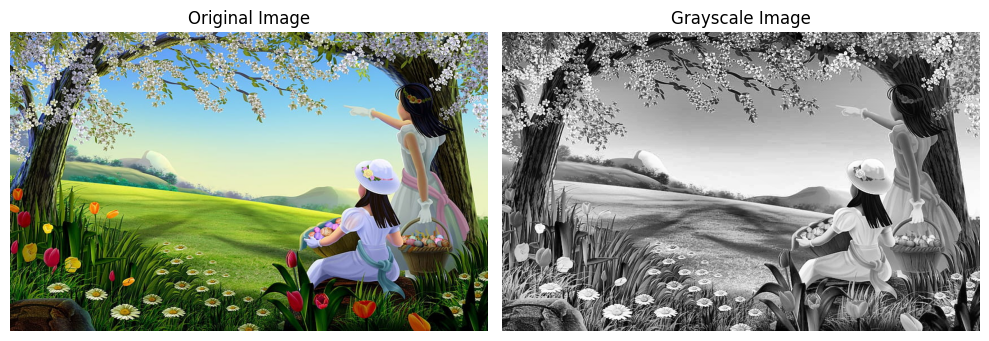

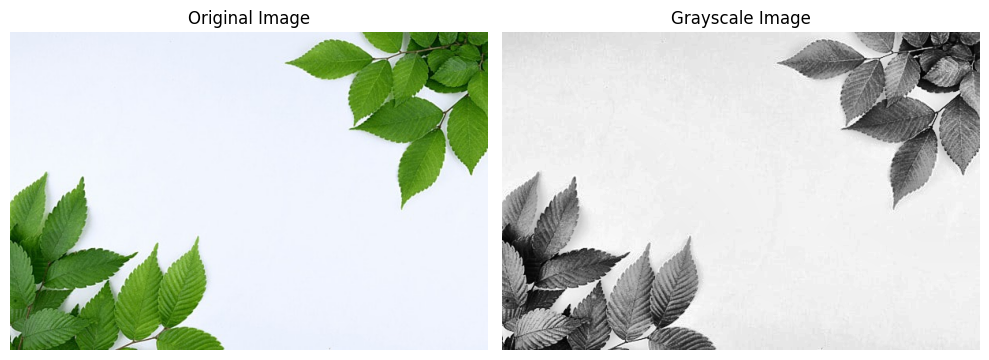

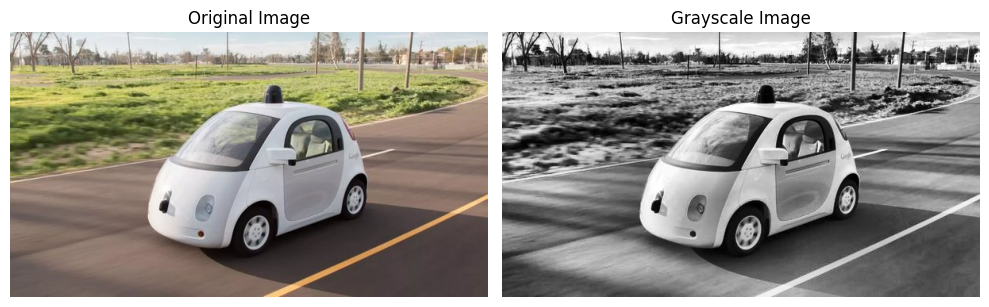

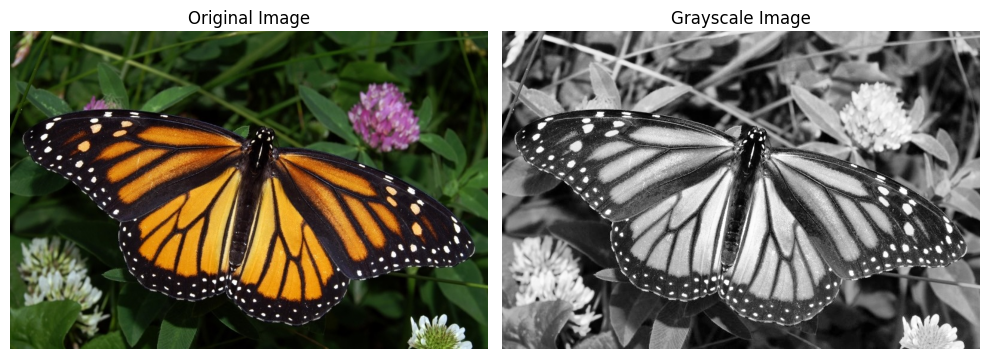

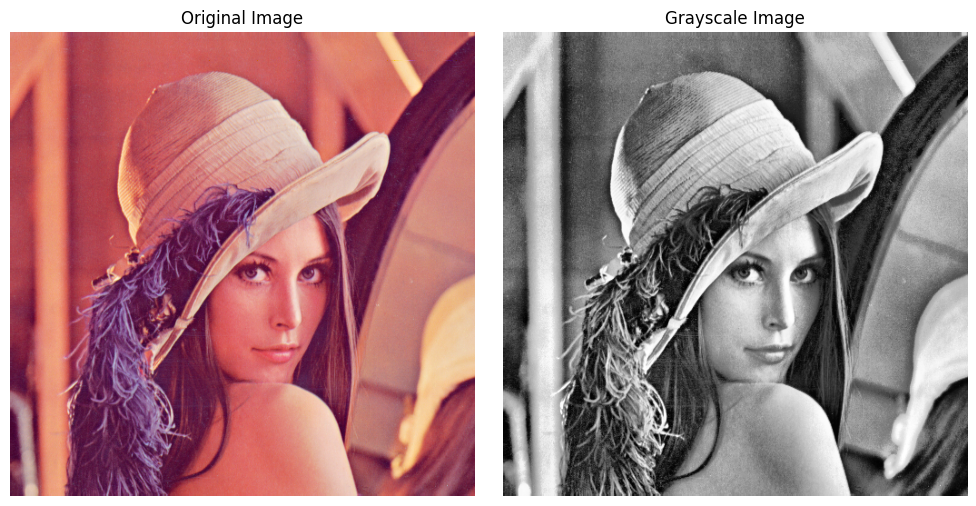

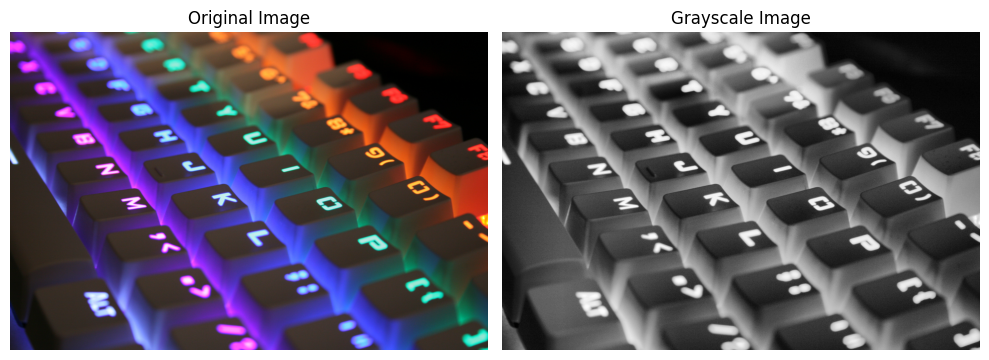

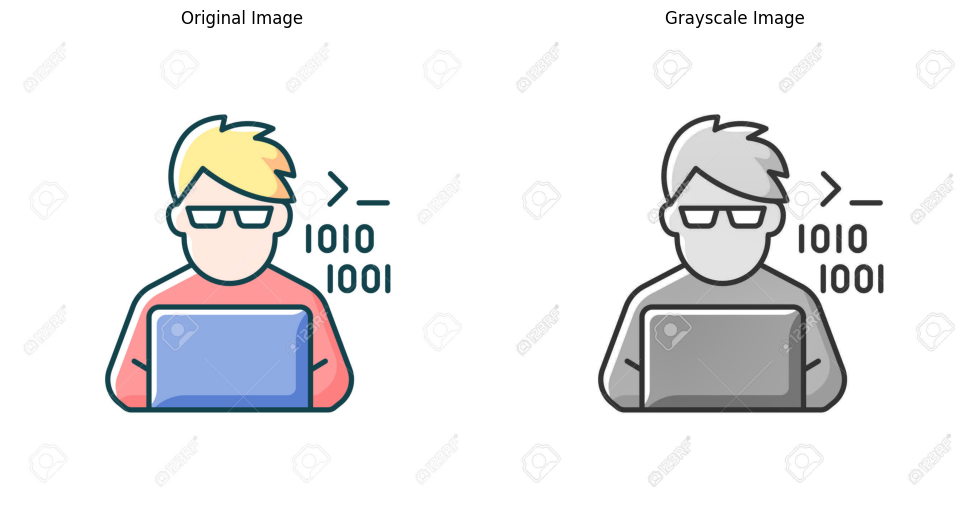

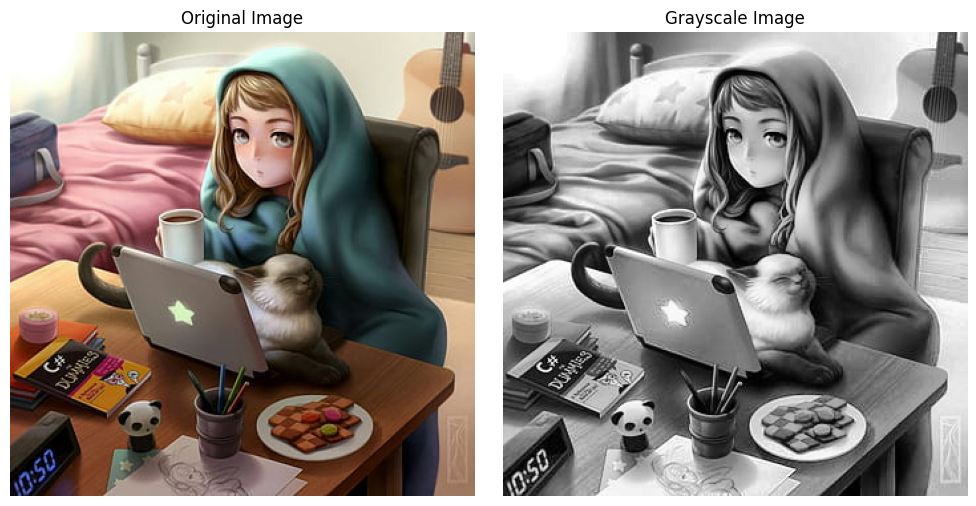

In [155]:
# converting images to grayscale

gray_img = []
for image_file in image_files:
  image_path = os.path.join(google_drive_folder, image_file)
  original_image = Image.open(image_path)
  new_image = cv2.imread(image_path)
  # Convert the image to grayscale using CLAHE (Contrast Limited Adaptive Histogram Equalization)
  clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(4, 4))
  gray_image = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
  enhanced_gray_image = clahe.apply(gray_image)

  gray_img.append(enhanced_gray_image)
  # Display the original and enhanced grayscale images
  plt.figure(figsize=(10, 5))
  plt.subplot(1, 2, 1)
  plt.imshow(original_image)
  plt.title('Original Image')
  plt.axis('off')

  plt.subplot(1, 2, 2)
  plt.imshow(enhanced_gray_image, cmap='gray', vmin=0, vmax=255)
  plt.title('Grayscale Image')
  plt.axis('off')

  plt.tight_layout()
  plt.show()
  print("\n")

##Part 2

In [156]:
from scipy import ndimage
from scipy.ndimage import convolve

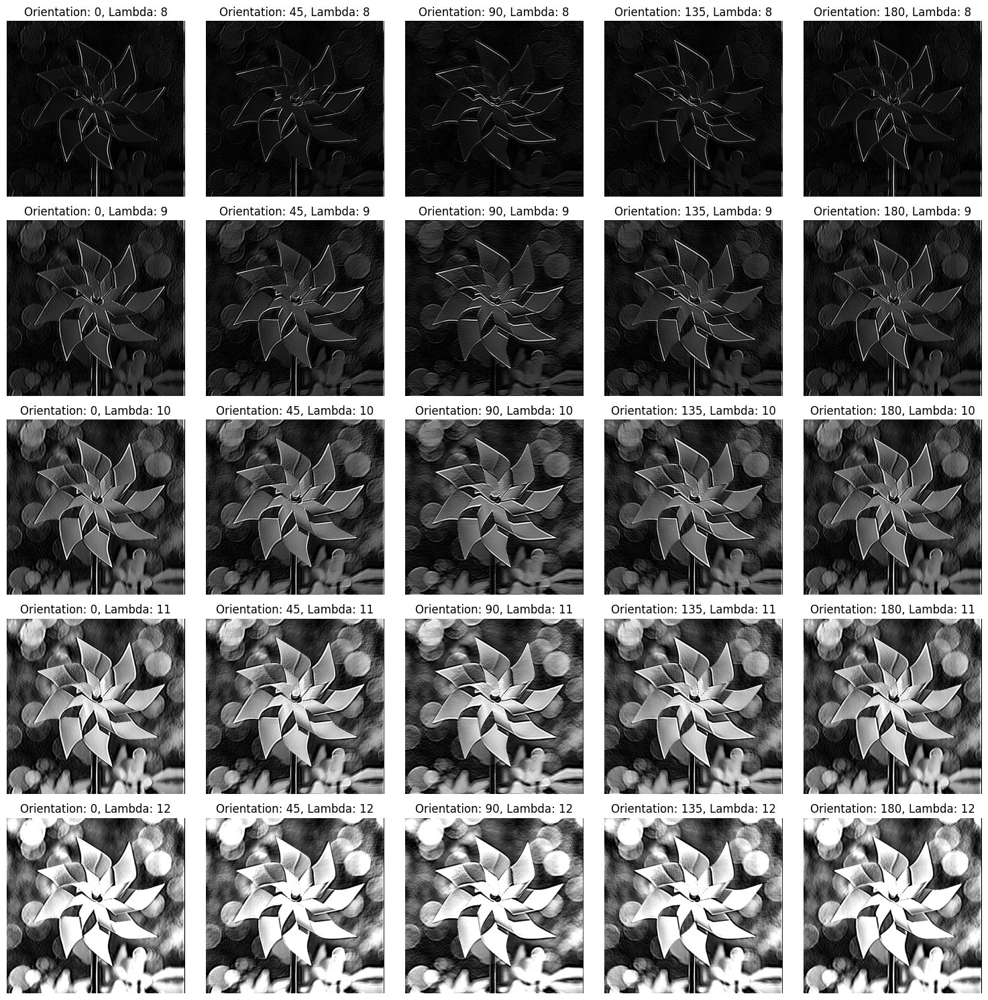

In [172]:


def gabor_filter(img_indx,thetas,frequencies):
  complex_images = []

  for frequency in frequencies:
      for theta in thetas:
          theta = np.radians(theta)
          kernel = cv2.getGaborKernel((31, 31), sigma=4, theta=theta, lambd=frequency, gamma=8, psi=0, ktype=cv2.CV_32F)
          complex_img = cv2.filter2D(gray_img[img_indx], cv2.CV_8UC3, kernel)
          complex_images.append(complex_img)
  return complex_images
thetas = [0, 45, 90, 135, 180]
frequencies = [8 , 9, 10, 11, 12]
#plotting grayscale images
complex_img = gabor_filter(1,thetas,frequencies)
plt.figure(figsize=(15, 15))

i = 0

while i < len(thetas) * len(frequencies):
    freq_idx = i // len(thetas)  # Calculate frequency index
    theta_idx = i % len(thetas)  # Calculate orientation index
    freq_val = frequencies[freq_idx]  # Get the corresponding frequency value
    theta_val = thetas[theta_idx]  # Get the corresponding orientation value

    # Plot the filtered image
    plt.subplot(len(frequencies), len(thetas), i + 1)
    plt.imshow(complex_img[i], cmap='gray')  # Use complex_img[i] to access the filtered images
    plt.title(f'Orientation: {theta_val}, Lambda: {freq_val}')
    plt.axis('off')

    # Increment the counter
    i += 1


plt.tight_layout()
plt.show()


##Part 3

3.1

In [158]:
#implementing WTA considering orientation and magnitude

def custom_wta(images, threshold):
    best_image = None  # Initialize the best image
    top_score = -1     # Initialize the top score
    counter = 0        # Initialize a counter

    while counter < len(images):
        current_image = images[counter]
        magnitude = np.abs(current_image)
        orientation = np.angle(current_image)

        custom_score = magnitude * (1 + np.cos(2 * orientation))

        # Check if the current image has a higher score than the current top image
        if np.max(custom_score) > np.max(top_score):
            top_score = custom_score
            best_image = current_image

        counter += 1

    return best_image


wta_image = custom_wta(complex_img,1)

3.2

In [159]:
import cv2
import numpy as np

def normalize_wta_output(wta_image):
    magnitude = np.abs(wta_image)

    # Normalization
    min_val = np.min(magnitude)
    max_val = np.max(magnitude)
    magnitude_normalized = ((magnitude - min_val) / (max_val - min_val) * 255).astype(np.uint8)

    # Histogram equalization for better visibility
    equalized_magnitude = cv2.equalizeHist(magnitude_normalized)

    # Combine the normalized magnitude with the original phase information
    normalized_image = equalized_magnitude * np.exp(1j * np.angle(wta_image))

    return normalized_image


normalized_wta_image = normalize_wta_output(wta_image)


3.3

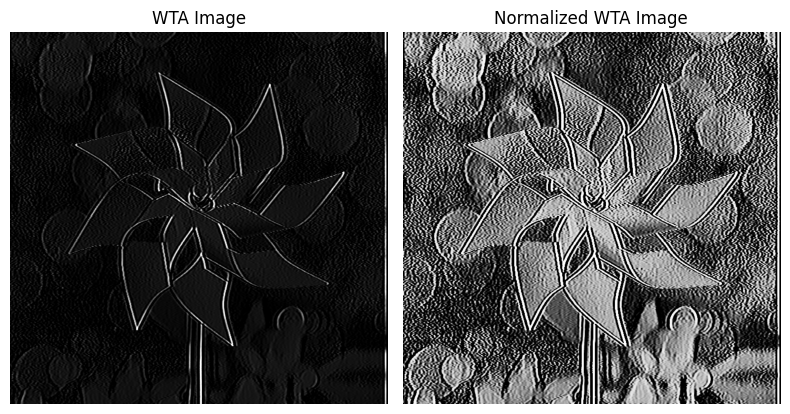

In [160]:
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.imshow(np.abs(wta_image), cmap='gray')
plt.title("WTA Image")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(np.abs(normalized_wta_image), cmap='gray')
plt.title("Normalized WTA Image")
plt.axis('off')

plt.tight_layout()
plt.show()

#Part 4

4.1

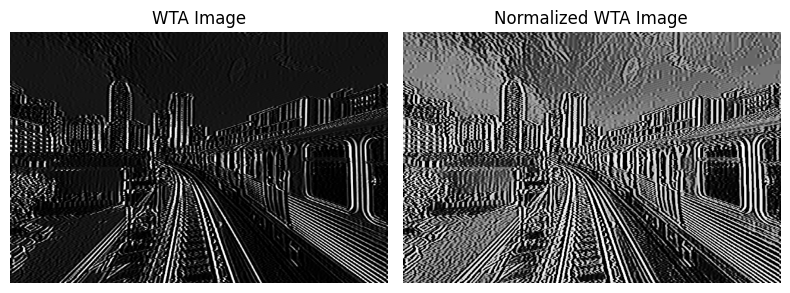

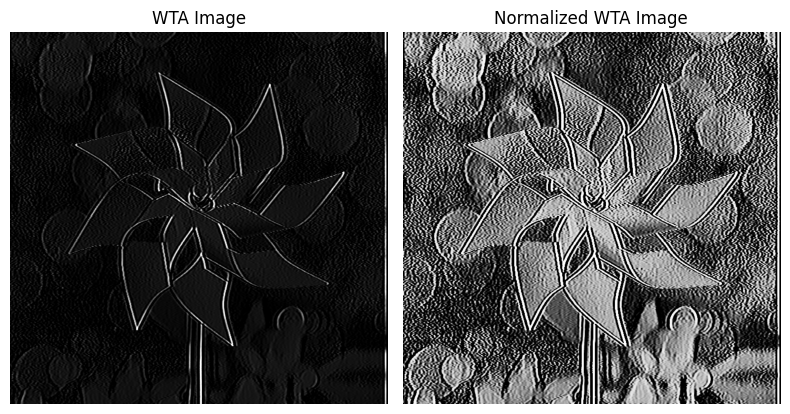

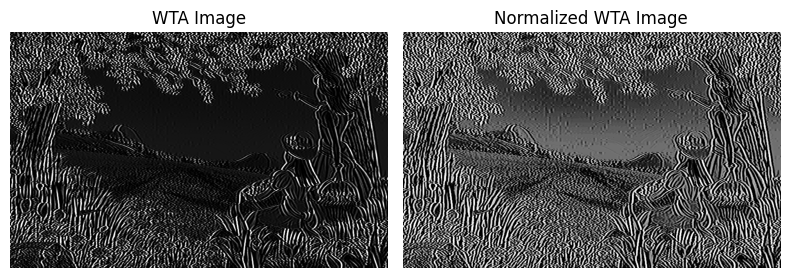

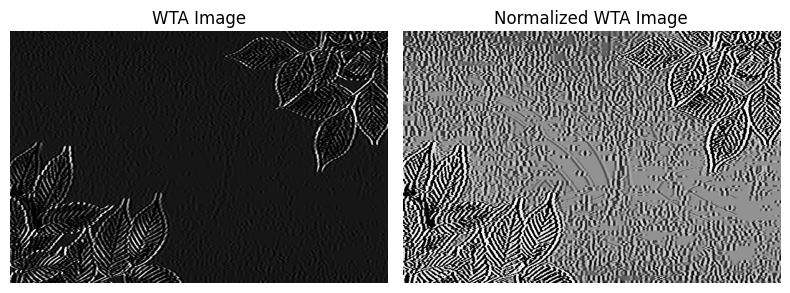

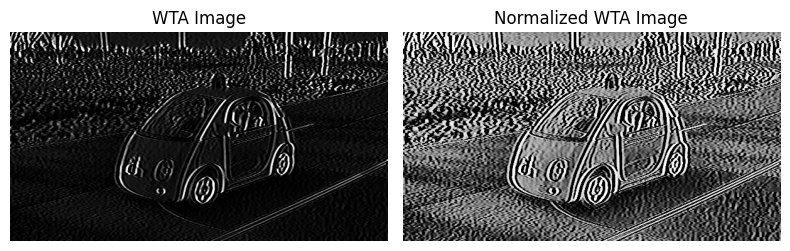

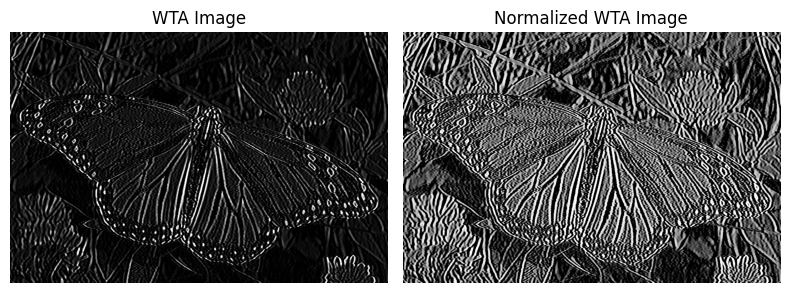

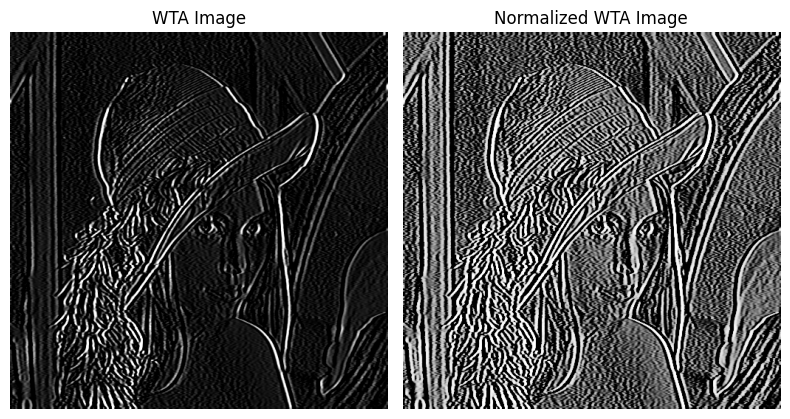

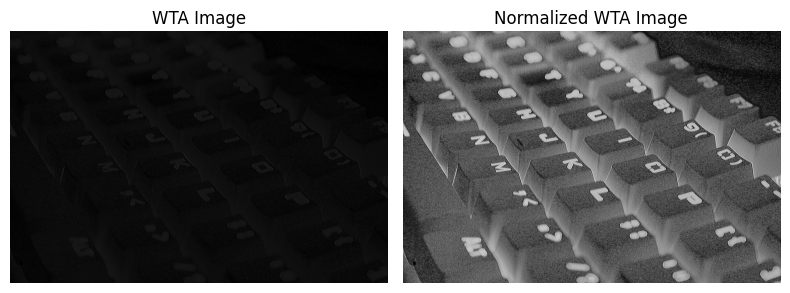

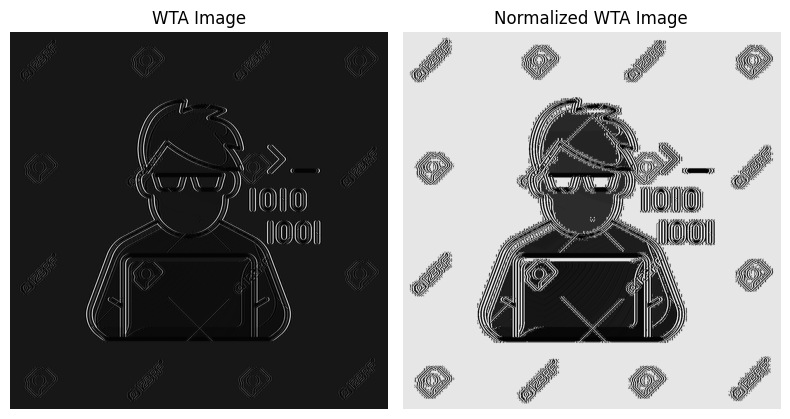

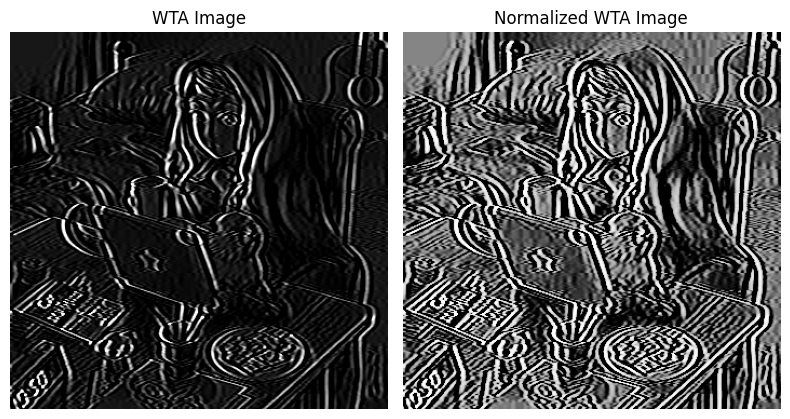

In [161]:
import matplotlib.pyplot as plt

for j in range(0, 10):
    grayscale_images = gabor_filter(j, thetas, frequencies)
    wta_img = custom_wta(grayscale_images, 1)
    normalized_wta_img = normalize_wta_output(wta_img)

    plt.figure(figsize=(8, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(np.abs(wta_img), cmap='gray')
    plt.title("WTA Image")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(np.abs(normalized_wta_img), cmap='gray')
    plt.title("Normalized WTA Image")
    plt.axis('off')

    plt.tight_layout()
    plt.show()
    print("\n")


4.3

In [162]:
def add_gaussian_noise(image, mean=0, std=25):
    # Generate noise with the same dimensions as the input image
    noise = np.random.normal(mean, std, image.shape).astype(np.uint8)
    noisy_image = cv2.add(image, noise) # use np.add instead of cv2.add
    return noisy_image

Text(0.5, 1.0, 'Noisy Image')

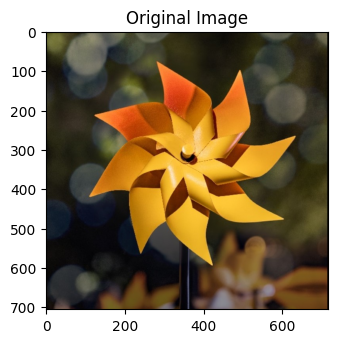

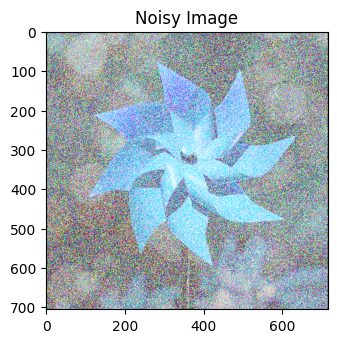

In [163]:
image_file = "2.jpg"
image_path = os.path.join(google_drive_folder, image_file)
original_image = Image.open(image_path)
new_image = cv2.imread(image_path)
noisy_image = add_gaussian_noise(new_image)
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.title('Original Image')
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.imshow(noisy_image)
plt.title('Noisy Image')

In [164]:
noise_img=[]
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(4, 4))
noise_gray_image = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
noise_enhanced_gray_image = clahe.apply(noise_gray_image)
noise_img.append(noise_enhanced_gray_image)

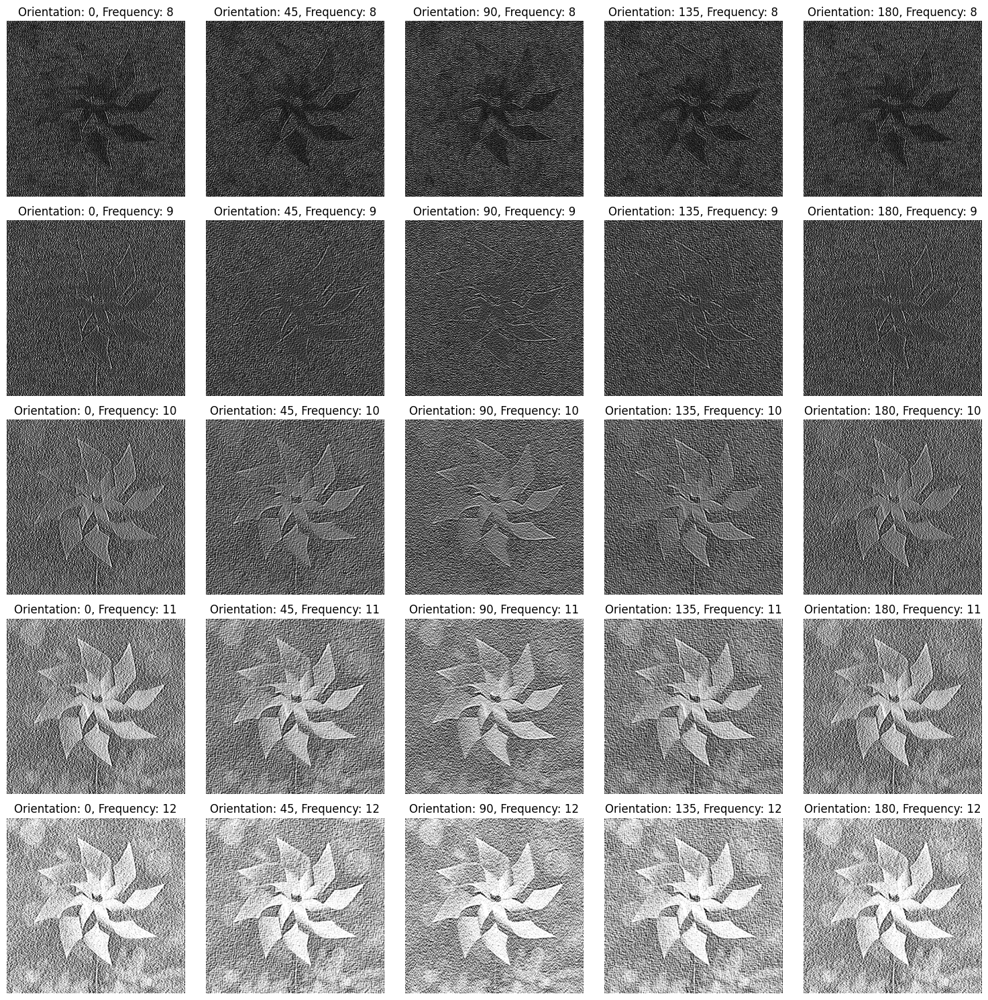

In [173]:

def gabor_filter_noise(indx,thetas,frequencies):
  complex_images = []

  for frequency in frequencies:
      for theta in thetas:
          theta = np.radians(theta)
          kernel = cv2.getGaborKernel((31, 31), sigma=4, theta=theta, lambd=frequency, gamma=8, psi=0, ktype=cv2.CV_32F)
          complex_img = cv2.filter2D(noise_img[indx], cv2.CV_8UC3, kernel)
          complex_images.append(complex_img)
  return complex_images
thetas = [0, 45, 90, 135, 180]
frequencies = [8 , 9, 10, 11, 12]

noise_complex_img = gabor_filter_noise(0,thetas,frequencies)
plt.figure(figsize=(15, 15))

i = 0

while i < len(thetas) * len(frequencies):
    freq_idx = i // len(thetas)  # Calculate frequency index
    theta_idx = i % len(thetas)  # Calculate orientation index
    freq_val = frequencies[freq_idx]  # Get the corresponding frequency value
    theta_val = thetas[theta_idx]  # Get the corresponding orientation value

    # Plot the filtered image
    plt.subplot(len(frequencies), len(thetas), i + 1)
    plt.imshow(noise_complex_img[i], cmap='gray')  # Use complex_img[i] to access the filtered images
    plt.title(f'Orientation: {theta_val}, Frequency: {freq_val}')
    plt.axis('off')

    # Increment the counter
    i += 1


plt.tight_layout()
plt.show()

4.4

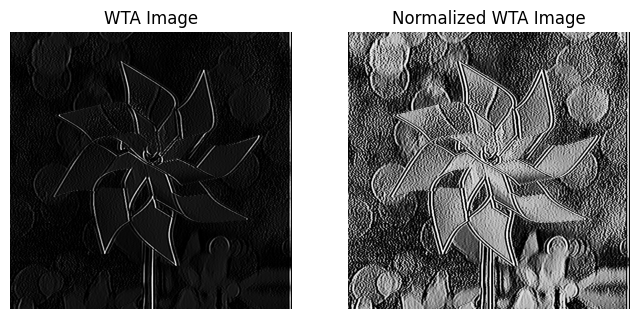

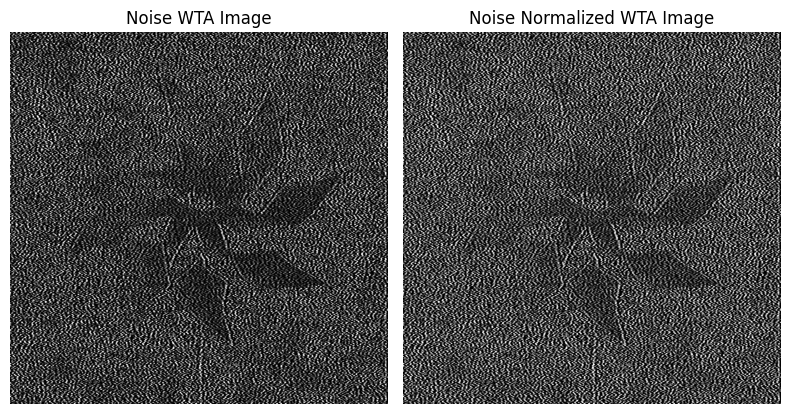

In [166]:
noise_wta_image = custom_wta(noise_complex_img,1)
noise_normalized_wta_image = normalize_wta_output(noise_wta_image)
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.imshow(np.abs(wta_image), cmap='gray')
plt.title("WTA Image")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(np.abs(normalized_wta_image), cmap='gray')
plt.title("Normalized WTA Image")
plt.axis('off')
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.imshow(np.abs(noise_wta_image), cmap='gray')
plt.title("Noise WTA Image")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(np.abs(noise_normalized_wta_image), cmap='gray')
plt.title("Noise Normalized WTA Image")
plt.axis('off')
plt.tight_layout()
plt.show()

In [167]:
# Check dimensions of the first image in each set
print("Dimensions of filtered_images[0]:", normalized_wta_image.shape)
print("Dimensions of noised_filtered_images[0]:", noise_normalized_wta_image.shape)


Dimensions of filtered_images[0]: (706, 717)
Dimensions of noised_filtered_images[0]: (706, 717)


In [168]:
from skimage.metrics import structural_similarity as ssim
import numpy as np

# Separating magnitude and phase components
magnitude_original = np.abs(normalized_wta_image)
phase_original = np.angle(normalized_wta_image)
magnitude_noisy = np.abs(noise_normalized_wta_image)
phase_noisy = np.angle(noise_normalized_wta_image)

# Calculating SSIM for magnitude and phase separately
ssim_magnitude = ssim(magnitude_original, magnitude_noisy)
ssim_phase = ssim(phase_original, phase_noisy)

# Combining the SSIM scores for magnitude and phase
ssim_score = (ssim_magnitude + ssim_phase) / 2

# Print and analyze the results
print(f"SSIM Score: {ssim_score}")


SSIM Score: 0.5182347272205994


## Part-5

5.1

(-0.5, 716.5, 705.5, -0.5)

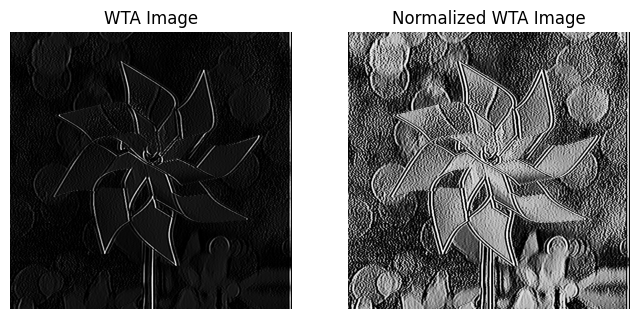

In [169]:
plt.figure(figsize=(8, 6))
plt.subplot(1, 2, 1)
plt.imshow(np.abs(wta_image), cmap='gray')
plt.title("WTA Image")
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(np.abs(normalized_wta_image), cmap='gray')
plt.title("Normalized WTA Image")
plt.axis('off')

5.2

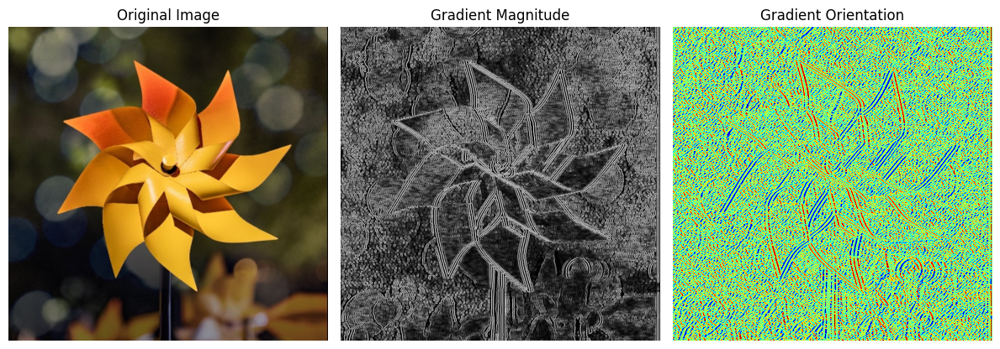

In [170]:

magnitude = np.abs(normalized_wta_image)
phase = np.angle(normalized_wta_image)

gradient_x = cv2.Sobel(magnitude, cv2.CV_64F, 1, 0, ksize=3)
gradient_y = cv2.Sobel(magnitude, cv2.CV_64F, 0, 1, ksize=3)

gradient_magnitude = np.sqrt(gradient_x**2 + gradient_y**2)
gradient_orientation = np.arctan2(gradient_y, gradient_x)

gradient_magnitude = cv2.normalize(gradient_magnitude, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(original_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(gradient_magnitude, cmap='gray')
plt.title('Gradient Magnitude')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(gradient_orientation, cmap='jet')
plt.title('Gradient Orientation')
plt.axis('off')

plt.tight_layout()
plt.show()